# ไฟล์นี้เป็นไฟล์เฉลย จะมีคำตอบครบ เหมาะกับการใช้เช็คคำตอบ

แต่ถ้าอยากเรียนรู้ไปพร้อมกับดูวีดิโอ Chapter 2 แนะนำให้ใช้ไฟล์เริ่มต้น (ลิงค์อยู่ในระบบเรียน)

**สำคัญ:** ถ้าคุณเปิดไฟล์นี้จากลิงค์ในระบบเรียน
กรุณากด File > Save a Copy in Drive เพื่อก็อปปี้ไฟล์นี้ไปก่อน

---

# ยินดีต้อนรับสู่ Workshop 2: Data Cleansing with Apache Spark

บริษัท Chic & Cozy มีข้อมูลจำนวนมาก Data Engineer จึงต้องนำข้อมูลมาทำความสะอาดเพื่อให้พร้อมใช้ ก่อนที่จะนำข้อมูลไปใช้งานต่อได้

## เทคโนโลยีที่เราจะโฟกัส:
- Apache Spark

## ภาพรวม Workshop นี้

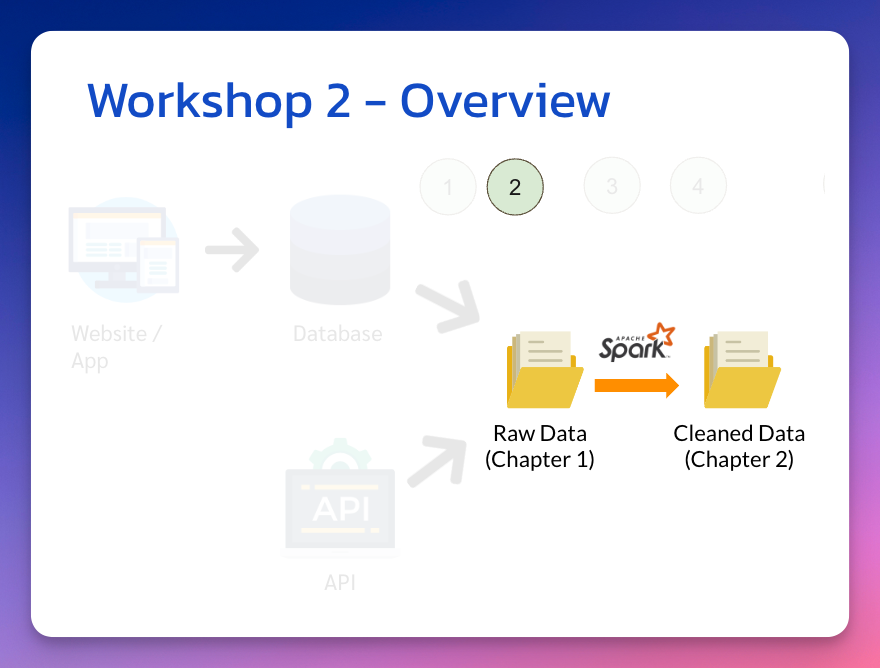

## ลิงค์ดีมีประโยชน์

### 1. หน้าเว็บไซต์รวมคำสั่งทั้งหมดของ PySpark

หน้าเว็บไซต์นี้อัพเดทข้อมูลโดยทีมงาน Apache Spark พร้อมวิธีใช้ และคำอธิบายค่าต่าง ๆ ที่คำสั่งนั้นสามารถรับได้ สามารถค้นหาคำสั่งที่ต้องการได้ด้วย

https://spark.apache.org/docs/latest/api/python/reference/index.html

### 2. [ภาษาอังกฤษ] Spark Cheatsheet by DataCamp

รวมคำสั่ง Spark

**RDD:**
https://www.datacamp.com/community/blog/pyspark-cheat-sheet-python

**DataFrame:**
https://www.datacamp.com/community/blog/pyspark-sql-cheat-sheet

### 3. [ภาษาไทย] Spark Cheatsheet by DataTH

รวมคำสั่ง Spark พร้อมตัวอย่างโค้ด และคำอธิบายภาษาไทย

https://blog.datath.com/cheatsheet-pyspark/

---

# มาเริ่ม Workshop 2 กันเลย

# Step 1) ติดตั้ง Spark และ PySpark

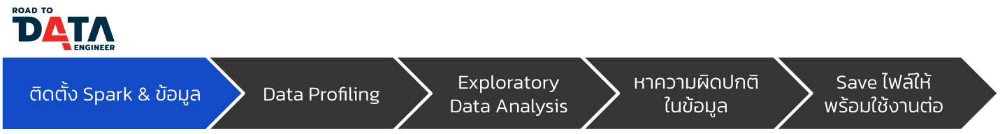

In [ ]:
!apt-get update                                                                          # อัพเดท Package ทั้งหมดใน VM ตัวนี้
!apt-get install openjdk-8-jdk-headless -qq > /dev/null                                  # ติดตั้ง Java Development Kit (จำเป็นสำหรับการติดตั้ง Spark)
!wget -q https://archive.apache.org/dist/spark/spark-3.5.1/spark-3.5.1-bin-hadoop3.tgz   # ติดตั้ง Spark 3.5.1
!tar xzvf spark-3.5.1-bin-hadoop3.tgz                                                    # Unzip ไฟล์ Spark 3.5.1
!pip install -q findspark                                                                # ติดตั้ง Package Python สำหรับเชื่อมต่อกับ Spark

# Set enviroment variable ให้ Python รู้จัก Spark
import os
os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-8-openjdk-amd64"
os.environ["SPARK_HOME"] = "/content/spark-3.5.1-bin-hadoop3"

# ติดตั้ง PySpark version 3.5.1 ลงใน Python
!pip install pyspark==3.5.1

Get:1 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Hit:2 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:3 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Hit:4 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Get:5 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,626 B]
Get:6 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Hit:7 https://ppa.launchpadcontent.net/c2d4u.team/c2d4u4.0+/ubuntu jammy InRelease
Get:8 http://security.ubuntu.com/ubuntu jammy-security/main amd64 Packages [1,858 kB]
Hit:9 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Get:10 http://archive.ubuntu.com/ubuntu jammy-updates/universe amd64 Packages [1,377 kB]
Get:11 http://security.ubuntu.com/ubuntu jammy-security/universe amd64 Packages [1,084 kB]
Get:12 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 Packages [2,129 kB]
Get:13 https://ppa.launchpadcontent.n

In [ ]:
# Server ของ Google Colab มีกี่ Core
!cat /proc/cpuinfo

processor	: 0
vendor_id	: GenuineIntel
cpu family	: 6
model		: 79
model name	: Intel(R) Xeon(R) CPU @ 2.20GHz
stepping	: 0
microcode	: 0xffffffff
cpu MHz		: 2199.998
cache size	: 56320 KB
physical id	: 0
siblings	: 2
core id		: 0
cpu cores	: 1
apicid		: 0
initial apicid	: 0
fpu		: yes
fpu_exception	: yes
cpuid level	: 13
wp		: yes
flags		: fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cmov pat pse36 clflush mmx fxsr sse sse2 ss ht syscall nx pdpe1gb rdtscp lm constant_tsc rep_good nopl xtopology nonstop_tsc cpuid tsc_known_freq pni pclmulqdq ssse3 fma cx16 pcid sse4_1 sse4_2 x2apic movbe popcnt aes xsave avx f16c rdrand hypervisor lahf_lm abm 3dnowprefetch invpcid_single ssbd ibrs ibpb stibp fsgsbase tsc_adjust bmi1 hle avx2 smep bmi2 erms invpcid rtm rdseed adx smap xsaveopt arat md_clear arch_capabilities
bugs		: cpu_meltdown spectre_v1 spectre_v2 spec_store_bypass l1tf mds swapgs taa mmio_stale_data retbleed bhi
bogomips	: 4399.99
clflush size	: 64
cache_alignment	: 64
ad

In [ ]:
# สร้าง Spark Session เพิ่อใช้งาน Spark
from pyspark.sql import SparkSession
spark = SparkSession.builder \
    .master("local[*]") \
      .appName("Road to Data Engineer 3.0 App") \
    .getOrCreate()

In [ ]:
# ดูเวอร์ชั่น Python
import sys
sys.version_info

sys.version_info(major=3, minor=10, micro=12, releaselevel='final', serial=0)

In [ ]:
# ดูเวอร์ชั่น Spark
spark.version

'3.5.1'

### อ่านข้อมูล

ดาวน์โหลดข้อมูลไฟล์ Parquet ที่ได้จากผลลัพธ์ของ Workshop 1 (+ มีแอบแก้ข้อมูลเล็กน้อย เพื่อให้ได้เรียนรู้การคลีนข้อมูลใน Workshop 2 นี้)

In [ ]:
!wget https://file.designil.com/f/6BamyF+ -O w2_input.parquet

--2024-06-01 05:13:23--  https://file.designil.com/f/6BamyF+
Resolving file.designil.com (file.designil.com)... 104.21.8.81, 172.67.130.97, 2606:4700:3031::6815:851, ...
Connecting to file.designil.com (file.designil.com)|104.21.8.81|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cdn-std.droplr.net/files/acc_513973/6BamyF [following]
--2024-06-01 05:13:23--  https://cdn-std.droplr.net/files/acc_513973/6BamyF
Resolving cdn-std.droplr.net (cdn-std.droplr.net)... 108.156.107.127, 108.156.107.32, 108.156.107.101, ...
Connecting to cdn-std.droplr.net (cdn-std.droplr.net)|108.156.107.127|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 6040473 (5.8M) [application/octet-stream]
Saving to: ‘w2_input.parquet’

w2_input.parquet    100%[===================>]   5.76M  --.-KB/s    in 0.09s   

2024-06-01 05:13:23 (64.5 MB/s) - ‘w2_input.parquet’ saved [6040473/6040473]



In [ ]:
dt = spark.read.parquet('w2_input.parquet')

dt

DataFrame[transaction_id: string, date: string, product_id: string, price: double, quantity: bigint, customer_id: double, product_name: string, customer_country: string, customer_name: string, total_amount: double, thb_amount: double]

In [ ]:
dt.show(10)

+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+
|transaction_id|      date|product_id|price|quantity|customer_id|        product_name|customer_country|customer_name|      total_amount|        thb_amount|
+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+
|        581482|2024-05-10|     22485|21.47|      12|    17490.0|Set Of 2 Wooden M...|  United Kingdom| Sara Griffin|            257.64|        11792.1828|
|        581475|2024-05-10|     22596|10.65|      36|    13069.0|Christmas Star Wi...|  United Kingdom| Michael Holt|383.40000000000003|17548.218000000004|
|        581475|2024-05-10|     23235|11.53|      12|    13069.0|Storage Tin Vinta...|  United Kingdom| Michael Holt|138.35999999999999|         6332.7372|
|        581475|2024-05-10|     23272|10.65|      12|    13069.0

# Step 2) Data Profiling

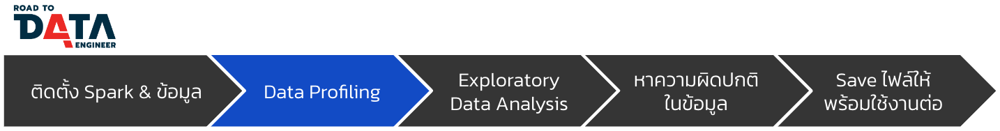

Data Profiling เป็นการทำความเข้าใจข้อมูลเบื้องต้น เพื่อที่เราจะได้รู้ว่าข้อมูลนี้มีคอลัมน์ไหนบ้าง ค่าโดยรวมเป็นอย่างไรบ้าง ฯลฯ เพื่อให้เราตัดสินใจได้ต่อว่าจะเช็คที่จุดไหนต่อไป

ตัวอย่าง: max, min, average, sum, มี missing value มั้ย ฯลฯ

In [ ]:
# ดูว่ามีคอลัมน์อะไรบ้าง
dt

DataFrame[transaction_id: string, date: string, product_id: string, price: double, quantity: bigint, customer_id: double, product_name: string, customer_country: string, customer_name: string, total_amount: double, thb_amount: double]

> ข้อมูลนี้มี 11 คอลัมน์:

| Column Name        | Data Type                          |
|--------------------|------------------------------------|
| `transaction_id`   | string (ตัวหนังสือ)                |
| `date`             | string                             |
| `product_id`       | string                             |
| `price`            | double (ตัวเลขมีทศนิยม)         |
| `quantity`         | bigint (ตัวเลขจำนวนเต็ม)           |
| `customer_id`      | double                             |
| `product_name`     | string                             |
| `customer_country` | string                             |
| `customer_name`    | string                             |
| `total_amount`     | double                             |
| `thb_amount`       | double                             |


In [ ]:
# ดูข้อมูล
dt.show()

+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+
|transaction_id|      date|product_id|price|quantity|customer_id|        product_name|customer_country|customer_name|      total_amount|        thb_amount|
+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+
|        581482|2024-05-10|     22485|21.47|      12|    17490.0|Set Of 2 Wooden M...|  United Kingdom| Sara Griffin|            257.64|        11792.1828|
|        581475|2024-05-10|     22596|10.65|      36|    13069.0|Christmas Star Wi...|  United Kingdom| Michael Holt|383.40000000000003|17548.218000000004|
|        581475|2024-05-10|     23235|11.53|      12|    13069.0|Storage Tin Vinta...|  United Kingdom| Michael Holt|138.35999999999999|         6332.7372|
|        581475|2024-05-10|     23272|10.65|      12|    13069.0

In [ ]:
# ดูข้อมูล 100 แถวแรก
dt.show(100)

+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+--------------+------------------+------------------+
|transaction_id|      date|product_id|price|quantity|customer_id|        product_name|customer_country| customer_name|      total_amount|        thb_amount|
+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+--------------+------------------+------------------+
|        581482|2024-05-10|     22485|21.47|      12|    17490.0|Set Of 2 Wooden M...|  United Kingdom|  Sara Griffin|            257.64|        11792.1828|
|        581475|2024-05-10|     22596|10.65|      36|    13069.0|Christmas Star Wi...|  United Kingdom|  Michael Holt|383.40000000000003|17548.218000000004|
|        581475|2024-05-10|     23235|11.53|      12|    13069.0|Storage Tin Vinta...|  United Kingdom|  Michael Holt|138.35999999999999|         6332.7372|
|        581475|2024-05-10|     23272|10.65|      12|    1

In [ ]:
# ดูข้อมูล 100 แถวแรก แบบไม่มี ...
dt.show(100, truncate = False)

+--------------+----------+----------+-----+--------+-----------+-----------------------------------+----------------+--------------+------------------+------------------+
|transaction_id|date      |product_id|price|quantity|customer_id|product_name                       |customer_country|customer_name |total_amount      |thb_amount        |
+--------------+----------+----------+-----+--------+-----------+-----------------------------------+----------------+--------------+------------------+------------------+
|581482        |2024-05-10|22485     |21.47|12      |17490.0    |Set Of 2 Wooden Market Crates      |United Kingdom  |Sara Griffin  |257.64            |11792.1828        |
|581475        |2024-05-10|22596     |10.65|36      |13069.0    |Christmas Star Wish List Chalkboard|United Kingdom  |Michael Holt  |383.40000000000003|17548.218000000004|
|581475        |2024-05-10|23235     |11.53|12      |13069.0    |Storage Tin Vintage Leaf           |United Kingdom  |Michael Holt  |138.359

In [ ]:
# ดูประเภทข้อมูลแต่ละคอลัมน์
dt.dtypes

[('transaction_id', 'string'),
 ('date', 'string'),
 ('product_id', 'string'),
 ('price', 'double'),
 ('quantity', 'bigint'),
 ('customer_id', 'double'),
 ('product_name', 'string'),
 ('customer_country', 'string'),
 ('customer_name', 'string'),
 ('total_amount', 'double'),
 ('thb_amount', 'double')]

In [ ]:
# อีกคำสั่งในการดูข้อมูลแต่ละคอลัมน์ (Schema)
dt.printSchema()

root
 |-- transaction_id: string (nullable = true)
 |-- date: string (nullable = true)
 |-- product_id: string (nullable = true)
 |-- price: double (nullable = true)
 |-- quantity: long (nullable = true)
 |-- customer_id: double (nullable = true)
 |-- product_name: string (nullable = true)
 |-- customer_country: string (nullable = true)
 |-- customer_name: string (nullable = true)
 |-- total_amount: double (nullable = true)
 |-- thb_amount: double (nullable = true)



nullable คือ ค่าสามารถเป็น null (ค่าว่างเปล่า) ได้





In [ ]:
# นับจำนวนแถวและ column
print((dt.count(), len(dt.columns)))

(536350, 11)


In [ ]:
# สรุปข้อมูลสถิติ
dt.describe().show()

+-------+------------------+----------+------------------+------------------+------------------+------------------+--------------------+----------------+-------------+------------------+--------------------+
|summary|    transaction_id|      date|        product_id|             price|          quantity|       customer_id|        product_name|customer_country|customer_name|      total_amount|          thb_amount|
+-------+------------------+----------+------------------+------------------+------------------+------------------+--------------------+----------------+-------------+------------------+--------------------+
|  count|            536350|    536350|            536350|            536350|            536350|            536295|              536350|          536350|       536350|            536350|              536350|
|   mean| 559978.9296258752|      NULL|27501.334602703962|12.662182287696377| 9.919347441036637|15227.893178194838|                NULL|            NULL|         NULL|1

In [ ]:
# อีกคำสั่งในการสรุปข้อมูลสถิติ
# Reference: https://spark.apache.org/docs/3.1.2/api/python/reference/api/pyspark.sql.DataFrame.summary.html

dt.summary().show()

+-------+------------------+----------+------------------+------------------+------------------+------------------+--------------------+----------------+-------------+------------------+--------------------+
|summary|    transaction_id|      date|        product_id|             price|          quantity|       customer_id|        product_name|customer_country|customer_name|      total_amount|          thb_amount|
+-------+------------------+----------+------------------+------------------+------------------+------------------+--------------------+----------------+-------------+------------------+--------------------+
|  count|            536350|    536350|            536350|            536350|            536350|            536295|              536350|          536350|       536350|            536350|              536350|
|   mean| 559978.9296258752|      NULL|27501.334602703962|12.662182287696377| 9.919347441036637|15227.893178194838|                NULL|            NULL|         NULL|1

In [ ]:
# สรุปข้อมูลสถิติเฉพาะ column ที่ระบุ
dt.select("price").describe().show()

+-------+------------------+
|summary|             price|
+-------+------------------+
|  count|            536350|
|   mean|12.662182287696377|
| stddev| 8.490450200816936|
|    min|              5.13|
|    max|            660.62|
+-------+------------------+



### Exercise 1

บอสอยากรู้ว่าคอลัมน์ไหนมี Missing Value บ้าง และแสดงข้อมูลแถวที่มี Missing Value ให้ดูหน่อย



In [ ]:
# Solution - คอลัมน์ไหน? ตอบ: customer_id
dt.summary("count").show()

+-------+--------------+------+----------+------+--------+-----------+------------+----------------+-------------+------------+----------+
|summary|transaction_id|  date|product_id| price|quantity|customer_id|product_name|customer_country|customer_name|total_amount|thb_amount|
+-------+--------------+------+----------+------+--------+-----------+------------+----------------+-------------+------------+----------+
|  count|        536350|536350|    536350|536350|  536350|     536295|      536350|          536350|       536350|      536350|    536350|
+-------+--------------+------+----------+------+--------+-----------+------------+----------------+-------------+------------+----------+



In [ ]:
# Solution - แสดงแถวข้อมูลที่มี Missing Value
dt.where( dt.customer_id.isNull() ).show()

+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+-------------+-------------------+-------------------+
|transaction_id|      date|product_id|price|quantity|customer_id|        product_name|customer_country|customer_name|       total_amount|         thb_amount|
+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+-------------+-------------------+-------------------+
|       C581406|2024-05-09|    46000M| 6.19|    -240|       NULL|Polyester Filler ...|  United Kingdom| Allen Morgan|-1485.6000000000001|         -68397.024|
|       C581406|2024-05-09|    46000S| 6.19|    -300|       NULL|Polyester Filler ...|  United Kingdom| Allen Morgan|-1857.0000000000002| -85496.28000000001|
|       C575153|2024-04-09|     22947|44.25|      -1|       NULL|Wooden Advent Cal...|  United Kingdom| Allen Morgan|             -44.25|-2036.4734999999998|
|       C574288|2024-04-04|     22178|25.37|      -1

### Bonus 1: YData Profiling เครื่องมือทำ EDA ที่ทำให้ชีวิตสบายมาก

<img src="https://camo.githubusercontent.com/2a859e96cdec98998f2e5aa4c58bed85f2db22ceed2362486aa93ec596c7226b/68747470733a2f2f6173736574732e79646174612e61692f6f73732f79646174612d70726f66696c696e675f626c61636b2e706e67" height="200">

GitHub - https://github.com/ydataai/ydata-profiling

In [ ]:
!pip install ydata-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 359.5/359.5 kB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 11.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 13.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 24.5 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27080 sha256=9a7c2d4b4d0f740032b0865f12ae59372f7a3a01323ba0ca07928bcfd4e7fb6f
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
from ydata_profiling import ProfileReport
profile = ProfileReport(dt.toPandas(), title="Profiling Report")

In [ ]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Step 3) EDA - Exploratory Data Analysis

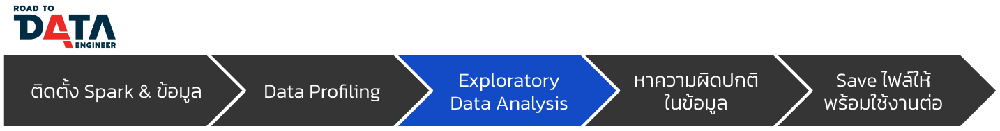

EDA = การใช้วิธี / เทคนิคต่าง ๆ เช่น
- เทคนิคทางสถิติ (Statistical techniques)
- การจัดกลุ่มข้อมูล (Data Aggregation)
- การแปลงข้อมูลเป็นกราฟฟิก (Data Visualization)

ฯลฯ

ในการวิเคราะห์หาคำตอบที่ต้องการจากข้อมูล

ใน Workshop นี้ เราจะมาลองทำ EDA แบบไม่มีกราฟฟิก (Non-Graphical) และแบบมีกราฟฟิก (Graphical)

## 1) Non-Graphical EDA

เราสามารถใช้คำสั่ง Spark ในการค้นหาข้อมูลที่ต้องการได้

In [ ]:
# ข้อมูลที่เป็นตัวเลข
dt.where(dt.price >= 100).show()

+--------------+----------+----------+------+--------+-----------+--------------------+----------------+--------------------+------------+------------------+
|transaction_id|      date|product_id| price|quantity|customer_id|        product_name|customer_country|       customer_name|total_amount|        thb_amount|
+--------------+----------+----------+------+--------+-----------+--------------------+----------------+--------------------+------------+------------------+
|        577130|2024-04-18|     22827|179.37|       1|    15861.0|Rustic Seventeen ...|  United Kingdom|        Kelly Barnes|      179.37|        8207.79183|
|       C577131|2024-04-18|     22827|179.37|      -1|    15861.0|Rustic Seventeen ...|  United Kingdom|        Kelly Barnes|     -179.37|       -8207.79183|
|        576635|2024-04-17|     22828|158.88|       2|    15269.0|Regency Mirror Wi...|  United Kingdom|     Jerry Henderson|      317.76|         14545.464|
|        576512|2024-04-16|     22823| 123.0|       

In [ ]:
# ข้อมูลที่เป็นตัวหนังสือ
dt.where(dt.customer_country == 'Australia').show()

+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+----------------+------------------+------------------+
|transaction_id|      date|product_id|price|quantity|customer_id|        product_name|customer_country|   customer_name|      total_amount|        thb_amount|
+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+----------------+------------------+------------------+
|        578459|2024-04-25|     22338| 6.19|      96|    12388.0|Star Decoration P...|       Australia|Stephanie Morris|            594.24|27531.139199999998|
|        578459|2024-04-25|     22600| 6.19|      20|    12388.0|Christmas Retrosp...|       Australia|Stephanie Morris|123.80000000000001|          5735.654|
|        578459|2024-04-25|     22910| 6.19|      20|    12388.0|Paper Chain Kit V...|       Australia|Stephanie Morris|123.80000000000001|          5735.654|
|        578459|2024-04-25|     22086| 6.19|  

### Exercise 2:
1. การซื้อทั้งหมดที่เกิดขึ้นในเดือนพฤษภาคม 2024 มีกี่แถว
2. การซื้อทั้งหมดที่เกิดขึ้นในเดือนมิถุนายน 2024 มีกี่แถว

In [ ]:
# Solution 2.1
dt.where( dt.date.startswith("2024-05") ).count()

28771

In [ ]:
# Solution 2.2
dt.where( dt.date.startswith("2024-06") ).count()

0

## 2) Graphical EDA


Spark ไม่ได้ถูกพัฒนามาเพื่องาน plot ข้อมูล เพราะฉะนั้นเราจะใช้ `pandas` ร่วมกับ package `seaborn`, `matplotlib` ในการ plot ข้อมูลแทน

เราจะมารู้จักกับ
1. Boxplot
2. Histogram
3. Scatterplot

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

In [ ]:
# แปลง Spark Dataframe เป็น Pandas Dataframe - ใช้เวลาประมาณ 11 วินาที
dt_pd = dt.toPandas()

In [ ]:
# ดูตัวอย่างข้อมูล
dt_pd.head()

,transaction_id,date,product_id,price,quantity,customer_id,product_name,customer_country,customer_name,total_amount,thb_amount
0,581482,2024-05-10,22485,21.47,12,17490.0,Set Of 2 Wooden Market Crates,United Kingdom,Sara Griffin,257.64,11792.1828
1,581475,2024-05-10,22596,10.65,36,13069.0,Christmas Star Wish List Chalkboard,United Kingdom,Michael Holt,383.40,17548.2180
2,581475,2024-05-10,23235,11.53,12,13069.0,Storage Tin Vintage Leaf,United Kingdom,Michael Holt,138.36,6332.7372
3,581475,2024-05-10,23272,10.65,12,13069.0,Tree T-Light Holder Willie Winkie,United Kingdom,Michael Holt,127.80,5849.4060
4,581475,2024-05-10,23239,11.94,6,13069.0,Set Of 4 Knick Knack Tins Poppies,United Kingdom,Michael Holt,71.64,3278.9628


<Axes: xlabel='price'>

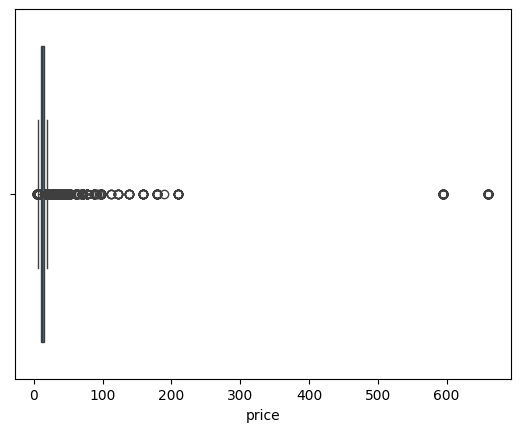

In [ ]:
# Plot 1) Boxplot - แสดงการกระจายตัวของข้อมูลตัวเลข
sns.boxplot(x = dt_pd['price'])

ดูยากจัง o_o ลองดูพลอตอีกแบบกันเถอะ

<Axes: xlabel='price', ylabel='Count'>

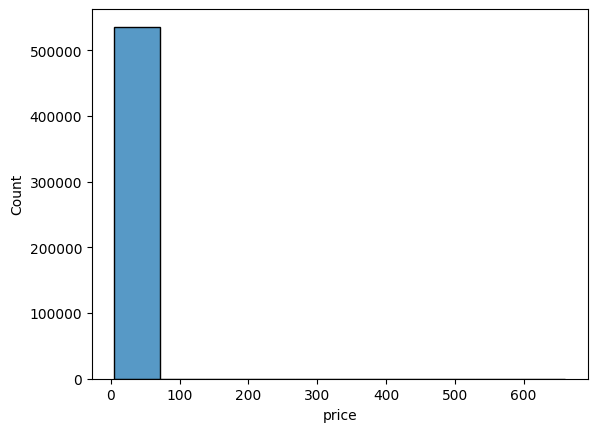

In [ ]:
# Plot 2) Histogram - แสดงการกระจายตัวของข้อมูลตัวเลข
# bins = จำนวน bar ที่ต้องการแสดง
sns.histplot(dt_pd['price'], bins=10)

<Axes: xlabel='price', ylabel='Count'>

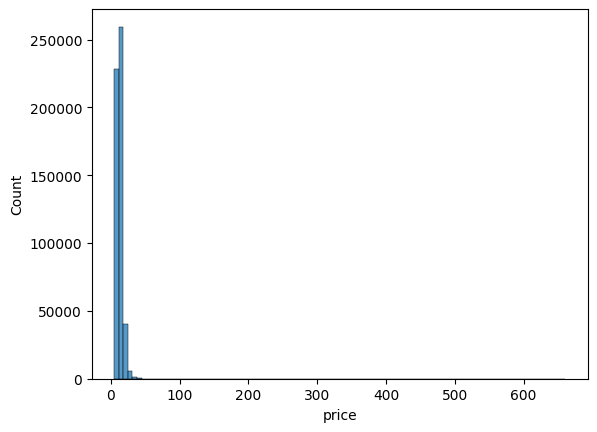

In [ ]:
# เพิ่ม bin เพื่อแสดงข้อมูลละเอียดขึ้น
sns.histplot(dt_pd['price'], bins=100)

### Exercise 3:
พลอตข้างบนมองยากจัง เราจะซูมเข้าไปอ่านค่ายังไงดี?

<Axes: xlabel='price', ylabel='Count'>

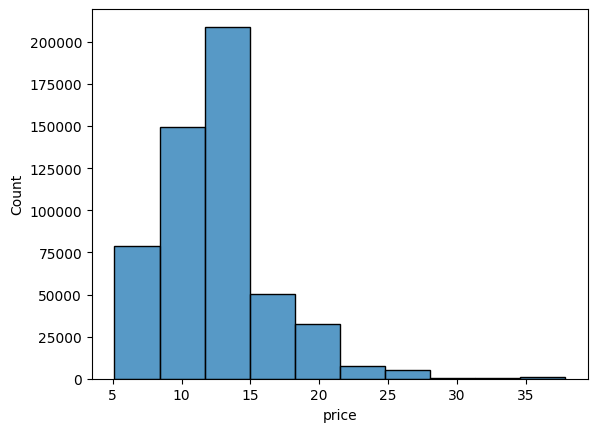

In [ ]:
# Solution - กำหนด range ราคาเพื่อซูม
sns.histplot(dt_pd[dt_pd['price'] < 40]['price'], bins=10)

----

<Axes: xlabel='quantity', ylabel='price'>

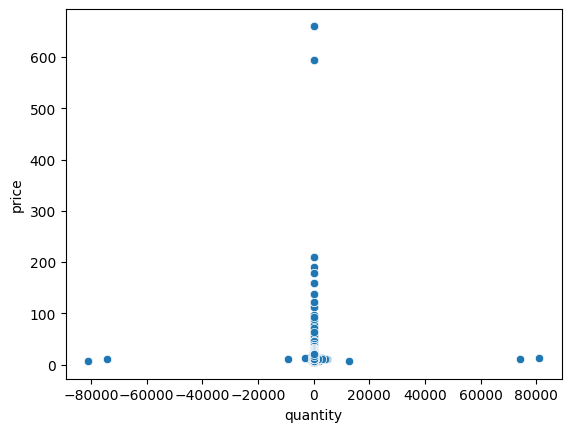

In [ ]:
# Plot 3) Scatterplot - แสดงความสัมพันธ์ระหว่าง 2 ตัวแปร
# เช่น ถ้าเราอยากรู้ว่า Quantity กับ Price สัมพันธ์กันแค่ไหน
sns.scatterplot(x=dt_pd.quantity, y=dt_pd.price)

### Bonus 2: สร้าง interactive chart ด้วย Plotly

In [ ]:
# Plotly - interactive chart (รันประมาณ 7 วินาที)
import plotly.express as px
fig = px.scatter(dt_pd, 'customer_id', 'price')
fig.show()

### Bonus 3: เครื่องมือช่วยสร้าง Data Visualization & EDA ข้อมูล ด้วย PyGWalker

![img](https://docs-us.oss-us-west-1.aliyuncs.com/img/pygwalker/frontpage-rendered.png)

GitHub - https://github.com/Kanaries/pygwalker

In [ ]:
!pip install pygwalker
import pygwalker as pyg

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.4/66.4 kB 7.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 956.2/956.2 kB 55.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 377.3/377.3 kB 33.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 57.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 49.5 MB/s eta 0:00:00
  Attempting uninstall: sqlglot
    Found existing installation: sqlglot 20.11.0
    Uninstalling sqlglot-20.11.0:
      Successfully uninstalled sqlglot-20.11.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bigframes 1.6.0 requires sqlglot<=20.11,>=20.8.0, but you have sqlglot 24.1.0 which is incompatible.
ibis-framework 8.0.0 requires sqlglot<=20.11,>=18.12.0, but you have sqlglot 24.

In [ ]:
pyg.walk(dt.toPandas())

Box(children=(HTML(value='<div id="ifr-pyg-000619cd36d65cfdNbfhDzkA7Yvc5iTx" style="height: auto">\n    <head>…

# Step 4) Data Cleansing with PySpark

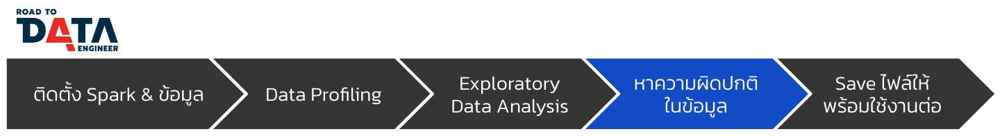

ในขั้นตอนนี้ เราจะมาหาปัญหา / ความผิดปกติในข้อมูล และทำความสะอาดกัน

ใน Workshop นี้จะพาไปเช็คความผิดปกติที่เจอบ่อย ๆ ในข้อมูล 5 แบบ
- Data Type
- Syntactical Anomalies
- Semantic Anomalies
- Missing Values
- Outliers

### Data Type

ปัญหาที่เจอบ่อยที่สุดแบบหนึ่งในข้อมูล คือ **Data Type ไม่ตรงกับที่เราต้องการ**

In [ ]:
# Show data
dt.show(truncate=False)

+--------------+----------+----------+-----+--------+-----------+-----------------------------------+----------------+-------------+------------------+------------------+
|transaction_id|date      |product_id|price|quantity|customer_id|product_name                       |customer_country|customer_name|total_amount      |thb_amount        |
+--------------+----------+----------+-----+--------+-----------+-----------------------------------+----------------+-------------+------------------+------------------+
|581482        |2024-05-10|22485     |21.47|12      |17490.0    |Set Of 2 Wooden Market Crates      |United Kingdom  |Sara Griffin |257.64            |11792.1828        |
|581475        |2024-05-10|22596     |10.65|36      |13069.0    |Christmas Star Wish List Chalkboard|United Kingdom  |Michael Holt |383.40000000000003|17548.218000000004|
|581475        |2024-05-10|23235     |11.53|12      |13069.0    |Storage Tin Vintage Leaf           |United Kingdom  |Michael Holt |138.359999999

In [ ]:
# Show schema
dt.printSchema()

root
 |-- transaction_id: string (nullable = true)
 |-- date: string (nullable = true)
 |-- product_id: string (nullable = true)
 |-- price: double (nullable = true)
 |-- quantity: long (nullable = true)
 |-- customer_id: double (nullable = true)
 |-- product_name: string (nullable = true)
 |-- customer_country: string (nullable = true)
 |-- customer_name: string (nullable = true)
 |-- total_amount: double (nullable = true)
 |-- thb_amount: double (nullable = true)



จะเห็นว่า `date` ถูกอ่านเป็นข้อมูลตัวหนังสือ (String) แต่เราอยากให้มันเป็นข้อมูลวันที่และเวลา (date time) จะทำยังไงดี?

ก่อนอื่น เราต้องมาดูก่อนว่าคอลัมน์ date ข้อมูลหน้าตาแบบไหน

In [ ]:
dt.select("date").show(10)

+----------+
|      date|
+----------+
|2024-05-10|
|2024-05-10|
|2024-05-10|
|2024-05-10|
|2024-05-10|
|2024-05-10|
|2024-05-10|
|2024-05-10|
|2024-05-10|
|2024-05-10|
+----------+
only showing top 10 rows



เราจะมาใช้ฟังก์ชั่น to_timestamp ซึ่งอยู่ใน pyspark.sql.functions กัน

Reference: https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.functions.to_timestamp.html

Date Format: https://spark.apache.org/docs/latest/sql-ref-datetime-pattern.html

In [ ]:
# แปลง string เป็น datetime
from pyspark.sql import functions as f

dt_clean = dt.withColumn("date",
                        f.to_timestamp(dt.date, 'yyyy-MM-dd')
                        )
dt_clean.show()

+--------------+-------------------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+
|transaction_id|               date|product_id|price|quantity|customer_id|        product_name|customer_country|customer_name|      total_amount|        thb_amount|
+--------------+-------------------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+
|        581482|2024-05-10 00:00:00|     22485|21.47|      12|    17490.0|Set Of 2 Wooden M...|  United Kingdom| Sara Griffin|            257.64|        11792.1828|
|        581475|2024-05-10 00:00:00|     22596|10.65|      36|    13069.0|Christmas Star Wi...|  United Kingdom| Michael Holt|383.40000000000003|17548.218000000004|
|        581475|2024-05-10 00:00:00|     23235|11.53|      12|    13069.0|Storage Tin Vinta...|  United Kingdom| Michael Holt|138.35999999999999|         6332.7372|
|        5

In [ ]:
# เกร็ดน่ารู้: ถ้าใช้ Date format มาตรฐานแล้ว ไม่ต้องกำหนด Date Format ตอนสั่ง to_timestamp ก็ได้
dt_clean = dt.withColumn("date",
                        f.to_timestamp(dt.date)
                        )
dt_clean.show()

+--------------+-------------------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+
|transaction_id|               date|product_id|price|quantity|customer_id|        product_name|customer_country|customer_name|      total_amount|        thb_amount|
+--------------+-------------------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+
|        581482|2024-05-10 00:00:00|     22485|21.47|      12|    17490.0|Set Of 2 Wooden M...|  United Kingdom| Sara Griffin|            257.64|        11792.1828|
|        581475|2024-05-10 00:00:00|     22596|10.65|      36|    13069.0|Christmas Star Wi...|  United Kingdom| Michael Holt|383.40000000000003|17548.218000000004|
|        581475|2024-05-10 00:00:00|     23235|11.53|      12|    13069.0|Storage Tin Vinta...|  United Kingdom| Michael Holt|138.35999999999999|         6332.7372|
|        5

In [ ]:
# เช็คจาก mix, max ของคอลัมน์ date ว่าข้อมูลมาครบมั้ย
dt_clean.select(
    f.min(dt_clean.date),
    f.max(dt_clean.date)
).show()

+-------------------+-------------------+
|          min(date)|          max(date)|
+-------------------+-------------------+
|2023-05-03 00:00:00|2024-05-10 00:00:00|
+-------------------+-------------------+



In [ ]:
dt_clean.printSchema()

root
 |-- transaction_id: string (nullable = true)
 |-- date: timestamp (nullable = true)
 |-- product_id: string (nullable = true)
 |-- price: double (nullable = true)
 |-- quantity: long (nullable = true)
 |-- customer_id: double (nullable = true)
 |-- product_name: string (nullable = true)
 |-- customer_country: string (nullable = true)
 |-- customer_name: string (nullable = true)
 |-- total_amount: double (nullable = true)
 |-- thb_amount: double (nullable = true)



## Bonus 4: ตัวอย่างการใช้ประโยชน์จากข้อมูล Datetime

In [ ]:
# นับยอด transaction ช่วงครึ่งเดือนแรก ของเดือนมกราคม 2024
dt_clean.where( (f.dayofmonth(dt_clean.date) <= 15) & ( f.month(dt_clean.date) == 1 ) & ( f.year(dt_clean.date) == 2024 ) ).count()

16398

In [ ]:
# เกร็ดน่ารู้: บางครั้งเราไม่แปลง Data type แต่ Spark ฉลาด แปลง String -> Timestamp ให้อัตโนมัติเลย
dt.where( (f.dayofmonth(dt.date) <= 15) & ( f.month(dt.date) == 1 ) & ( f.year(dt.date) == 2024 ) ).count()

16398

## Anomalies Check

ใช้ Spark ตามหาสิ่งที่ผิดปกติในข้อมูล

### ความผิดปกติ 1) Syntactical Anomalies
**Lexical errors** เช่น สะกดผิด

#### Exercise 4

หาชื่อประเทศที่สะกดผิด แล้วแก้ชื่อที่สะกดผิดให้ถูก

คุณเห็นชื่อประเทศที่สะกดผิดในคอลัมน์ Country มั้ย

In [ ]:
# ใน Data set ชุดนี้ มีข้อมูลจากกี่ประเทศ
dt_clean.select("customer_country").distinct().count()

39

In [ ]:
# แทนที่เลข 0 ด้วยจำนวนประเทศ เพื่อดูรายชื่อประเทศทั้งหมด
# sort = ทำให้ข้อมูลเรียงตามตัวอักษร อ่านง่ายขึ้น
# show() ถ้าไม่ใส่ตัวเลขจะขึ้นมาแค่ 20 อัน
dt_clean.select("customer_country").distinct().sort("customer_country").show( 40 )

+--------------------+
|    customer_country|
+--------------------+
|           Australia|
|             Austria|
|             Bahrain|
|             Belgium|
|              Brazil|
|              Canada|
|     Channel Islands|
|              Cyprus|
|      Czech Republic|
|             Denmark|
|                EIRE|
|  European Community|
|             Finland|
|              France|
|             Germany|
|              Greece|
|           Hong Kong|
|             Iceland|
|              Israel|
|               Italy|
|               Japan|
|              Japane|
|             Lebanon|
|           Lithuania|
|               Malta|
|         Netherlands|
|              Norway|
|              Poland|
|            Portugal|
|                 RSA|
|        Saudi Arabia|
|           Singapore|
|               Spain|
|              Sweden|
|         Switzerland|
|                 USA|
|United Arab Emirates|
|      United Kingdom|
|         Unspecified|
+--------------------+



เจอชื่อประเทศแปลก ๆ มั้ย?

มาดูกันว่าประเทศที่ชื่อผิด มีข้อมูลหน้าตาเป็นอย่างไร

In [ ]:
# สำคัญ: เปลี่ยน aaa เป็นชื่อประเทศที่คุณคิดว่าผิด
dt_clean.where(dt_clean['customer_country'] == 'Japane').show()

+--------------+-------------------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------+-----------+
|transaction_id|               date|product_id|price|quantity|customer_id|        product_name|customer_country|customer_name|total_amount| thb_amount|
+--------------+-------------------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------+-----------+
|        566623|2024-02-14 00:00:00|     21787|11.12|      72|    12756.0|Rain Poncho Retro...|          Japane|    Troy Ball|      800.64|36331.44192|
|        566623|2024-02-14 00:00:00|     21786|10.68|      24|    12756.0|   Polkadot Rain Hat|          Japane|    Troy Ball|      256.32|11631.28896|
|        566623|2024-02-14 00:00:00|     21789|11.12|      24|    12756.0|  Kids Rain Mac Pink|          Japane|    Troy Ball|      266.88|12110.48064|
|        566623|2024-02-14 00:00:00|     21788|11.12|      24|    12756.0|  Kids Rain Ma

ได้เวลาลองเปลี่ยนชื่อประเทศให้สะกดถูกต้อง

In [ ]:
# สำคัญ: เปลี่ยน aaa เป็นชื่อประเทศที่คุณคิดว่าผิด และ bbb เป็นชื่อประเทศที่ถูกต้อง
from pyspark.sql.functions import when

dt_clean_country = dt_clean.withColumn("customer_country_update", when(dt_clean['customer_country'] == 'Japane', 'Japan').otherwise(dt_clean['customer_country']))

In [ ]:
# ตรวจสอบข้อมูลที่แก้ไขแล้ว
dt_clean_country.select("customer_country_update").distinct().sort("customer_country_update").show(40)

+-----------------------+
|customer_country_update|
+-----------------------+
|              Australia|
|                Austria|
|                Bahrain|
|                Belgium|
|                 Brazil|
|                 Canada|
|        Channel Islands|
|                 Cyprus|
|         Czech Republic|
|                Denmark|
|                   EIRE|
|     European Community|
|                Finland|
|                 France|
|                Germany|
|                 Greece|
|              Hong Kong|
|                Iceland|
|                 Israel|
|                  Italy|
|                  Japan|
|                Lebanon|
|              Lithuania|
|                  Malta|
|            Netherlands|
|                 Norway|
|                 Poland|
|               Portugal|
|                    RSA|
|           Saudi Arabia|
|              Singapore|
|                  Spain|
|                 Sweden|
|            Switzerland|
|                    USA|
|   United A

In [ ]:
# ดูหน้าตาข้อมูลตอนนี้
dt_clean_country.show()

+--------------+-------------------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+-----------------------+
|transaction_id|               date|product_id|price|quantity|customer_id|        product_name|customer_country|customer_name|      total_amount|        thb_amount|customer_country_update|
+--------------+-------------------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+-----------------------+
|        581482|2024-05-10 00:00:00|     22485|21.47|      12|    17490.0|Set Of 2 Wooden M...|  United Kingdom| Sara Griffin|            257.64|        11792.1828|         United Kingdom|
|        581475|2024-05-10 00:00:00|     22596|10.65|      36|    13069.0|Christmas Star Wi...|  United Kingdom| Michael Holt|383.40000000000003|17548.218000000004|         United Kingdom|
|        581475|2024-05-10 00:00:00|     23235|11.53|  

In [ ]:
# เอาคอลัมน์ customer_country_update ไปแทนที่คอลัมน์ country
dt_clean_v2 = dt_clean_country.drop("customer_country").withColumnRenamed('customer_country_update', 'customer_country')

In [ ]:
# ดูหน้าตาข้อมูล
dt_clean_v2[ dt_clean_v2.transaction_id == '576923' ].show()

+--------------+-------------------+----------+-----+--------+-----------+--------------------+-------------+------------------+------------------+----------------+
|transaction_id|               date|product_id|price|quantity|customer_id|        product_name|customer_name|      total_amount|        thb_amount|customer_country|
+--------------+-------------------+----------+-----+--------+-----------+--------------------+-------------+------------------+------------------+----------------+
|        576923|2024-04-18 00:00:00|     23009|25.57|      18|    12753.0|I Love London Bab...| Sandra Black|            460.26|       21061.03734|           Japan|
|        576923|2024-04-18 00:00:00|     22660|17.51|      50|    12753.0|Doormat I Love Lo...| Sandra Black| 875.5000000000001|        40062.0045|           Japan|
|        576923|2024-04-18 00:00:00|     20750|16.76|      48|    12753.0|Red Retrospot Min...| Sandra Black|            804.48|       36812.20032|           Japan|
|        5

### ความผิดปกติ 2) Semantic Anomalies

**Integrity constraints**: ค่าอยู่นอกเหนือขอบเขตของค่าที่รับได้ เช่น product_id ยาวกว่าที่ควรจะเป็น

In [ ]:
# ดูว่าข้อมูล product_id ตอนนี้หน้าตาเป็นอย่างไร
dt_clean_v2.select("product_id").show(100)

+----------+
|product_id|
+----------+
|     22485|
|     22596|
|     23235|
|     23272|
|     23239|
|     21705|
|     22118|
|     22119|
|     22217|
|     22216|
|     22380|
|     22442|
|     22664|
|     22721|
|     22723|
|     22785|
|     22955|
|     23141|
|     22956|
|     22581|
|     23198|
|     23197|
|     23184|
|     23168|
|     23167|
|     23166|
|     23165|
|     23004|
|     23002|
|     23000|
|     22998|
|     22994|
|     22835|
|     22730|
|     22728|
|     22727|
|     22726|
|     22720|
|     22693|
|     22670|
|     22667|
|     22666|
|     22631|
|     22628|
|     22467|
|     22197|
|     22114|
|     22112|
|     21908|
|     21874|
|     21872|
|     21871|
|     21533|
|     21481|
|     21479|
|     21248|
|     21216|
|     21181|
|     21175|
|     21169|
|     21162|
|     21159|
|     21158|
|     21154|
|     16016|
|     16014|
|     16008|
|     85152|
|    84596F|
|    84596B|
|    84510A|
|     82600|
|     82581|
|     72232|

In [ ]:
# นับจำนวน product_id ทั้งหมด
dt_clean_v2.select("product_id").count()

536350

#### Exercise 5

ทีมบอกว่า ให้แทนค่า product_id ที่เกิน 5 ตัวอักษร ให้กลายเป็น 5 ตัวอักษรให้หมด

##### Solution
1. ดูว่า product_id ตรงตามรูปแบบที่เราต้องการทั้งหมดมั้ย

คำใบ้: ใช้เว็บไซต์ https://www.regex101.com เพื่อสร้าง Regular Expression ตามรูปแบบที่เราต้องการ

In [ ]:
# หาว่า product_id เป็นตัวหนังสือ 5 ตัวทั้งหมดมั้ย
# = ค่าที่ถูก / ค่าทั้งหมด = ถ้าถูกหมดจะเป็น 1.0 แต่ถ้าไม่ได้ถูกหมด ผลลัพธ์จะต่ำกว่านั้น

# สำคัญ: แทนที่ ... ด้วย Regular Expression ของรูปแบบ product_id ที่เราต้องการ
dt_clean_v2.where(dt_clean_v2["product_id"].rlike("^.{5}$")).count() / dt_clean_v2.count()

0.9050601286473385

แปลว่ามีข้อมูลที่ไม่ได้อยู่ในรูปแบบที่เราต้องการอยู่บางส่วน (10%)

2. มาลองดูข้อมูลที่ไม่ถูกต้อง ว่าหน้าตาเป็นแบบไหน

In [ ]:
# สำคัญ: แทนที่ ... ด้วย Regular Expression ของรูปแบบ product_id ที่เราต้องการ
dt_correct_product = dt_clean_v2.filter(dt_clean_v2["product_id"].rlike("^.{5}$"))
dt_incorrect_product = dt_clean_v2.subtract(dt_correct_product)

dt_incorrect_product.show(10)
# คำเตือน: Cell นี้อาจจะใช้เวลาประมาณ 10 วินาที

+--------------+-------------------+----------+-----+--------+-----------+--------------------+---------------+------------------+------------------+----------------+
|transaction_id|               date|product_id|price|quantity|customer_id|        product_name|  customer_name|      total_amount|        thb_amount|customer_country|
+--------------+-------------------+----------+-----+--------+-----------+--------------------+---------------+------------------+------------------+----------------+
|        581480|2024-05-10 00:00:00|    84029E|14.61|       8|    14441.0|Red Woolly Hottie...|    Thomas Hull|            116.88|         5349.5976|  United Kingdom|
|        580727|2024-05-06 00:00:00|    47504H| 5.97|       6|    14096.0|English Rose Spir...|Christine Doyle|             35.82|         1652.7348|  United Kingdom|
|        580727|2024-05-06 00:00:00|    85231B| 7.24|       1|    14096.0|Cinammon Set Of 9...|Christine Doyle|              7.24|          334.0536|  United Kingdom

In [ ]:
# เช็คต่ออีกนิด ว่าตัวหนังสือด้านหลัง product_id คืออะไร
dt_clean_v2.where( dt_clean_v2['product_id'].startswith('15044') ).select('product_id', 'product_name').show(truncate = False)

+----------+--------------------+
|product_id|product_name        |
+----------+--------------------+
|15044C    |Purple Paper Parasol|
|15044A    |Pink Paper Parasol  |
|15044D    |Red Paper Parasol   |
|15044C    |Purple Paper Parasol|
|15044A    |Pink Paper Parasol  |
|15044A    |Pink Paper Parasol  |
|15044D    |Red Paper Parasol   |
|15044D    |Red Paper Parasol   |
|15044C    |Purple Paper Parasol|
|15044A    |Pink Paper Parasol  |
|15044D    |Red Paper Parasol   |
|15044A    |Pink Paper Parasol  |
|15044C    |Purple Paper Parasol|
|15044C    |Purple Paper Parasol|
|15044D    |Red Paper Parasol   |
|15044D    |Red Paper Parasol   |
|15044C    |Purple Paper Parasol|
|15044A    |Pink Paper Parasol  |
|15044A    |Pink Paper Parasol  |
|15044A    |Pink Paper Parasol  |
+----------+--------------------+
only showing top 20 rows



ทำให้เรารู้ว่า... ตัวหนังสือด้านหลังของ Product_id เลข 5 ตัว หมายถึง รูปแบบ (variation) ของสินค้า

เช่น สินค้าที่มีหลายสี (ตัวอย่างข้างบน A = "Pink", C = "Purple", D = "Red")

เพราะฉะนั้นเราตัดตัวหนังสือใน product_id ออกได้ (ตามที่ทีมอยากได้)

3. มาแทนค่า product_id กันเถอะ

In [ ]:
dt_clean_v3 = dt_clean_v2.withColumn('product_id', f.substring('product_id', 1, 5))

In [ ]:
# ตรวจสอบผลลัพธ์
dt_correct_product = dt_clean_v3.filter(dt_clean_v3["product_id"].rlike("^.{5}$"))
dt_incorrect_product = dt_clean_v3.subtract(dt_correct_product)

dt_incorrect_product.show(10)

+--------------+----+----------+-----+--------+-----------+------------+-------------+------------+----------+----------------+
|transaction_id|date|product_id|price|quantity|customer_id|product_name|customer_name|total_amount|thb_amount|customer_country|
+--------------+----+----------+-----+--------+-----------+------------+-------------+------------+----------+----------------+
+--------------+----+----------+-----+--------+-----------+------------+-------------+------------+----------+----------------+



เสร็จเรียบร้อย ไม่เหลือ Product_id ที่ผิดรูปแบบแล้ว เย้

### ความผิดปกติ 3) Missing values

การเช็คและแก้ไข Missing Values (หากจำเป็น)

ค่า Missing Value คือ ค่าที่ว่างเปล่า

เราจะรู้ได้ยังไงว่าคอลัมน์ไหนมีค่าว่างเปล่ากี่ค่า

In [ ]:
# วิธีที่ 1 ในการเช็ค Missing Value
# ใช้เทคนิค List Comparehension - ทบทวนได้ใน Week 1 ช่วง Basic Python
# เช่น [ print(i) for i in [1,2,3] ]

# col = คำสั่ง Spark ในการเลือกคอลัมน์
# sum = คำสั่ง Spark ในการคิดผลรวม
from pyspark.sql.functions import col, sum

dt_nulllist = dt_clean_v3.select([ sum(col(colname).isNull().cast("int")).alias(colname) for colname in dt_clean_v3.columns ])
dt_nulllist.show()

+--------------+----+----------+-----+--------+-----------+------------+-------------+------------+----------+----------------+
|transaction_id|date|product_id|price|quantity|customer_id|product_name|customer_name|total_amount|thb_amount|customer_country|
+--------------+----+----------+-----+--------+-----------+------------+-------------+------------+----------+----------------+
|             0|   0|         0|    0|       0|         55|           0|            0|           0|         0|               0|
+--------------+----+----------+-----+--------+-----------+------------+-------------+------------+----------+----------------+



In [ ]:
# วิธีที่ 2 ในการเช็ค Missing Value - จาก Exercise 1 โค้ดสะอาดกว่ามาก แต่ต้องมาบวกลบเอง
dt_clean_v3.summary("count").show()

+-------+--------------+----------+------+--------+-----------+------------+-------------+------------+----------+----------------+
|summary|transaction_id|product_id| price|quantity|customer_id|product_name|customer_name|total_amount|thb_amount|customer_country|
+-------+--------------+----------+------+--------+-----------+------------+-------------+------------+----------+----------------+
|  count|        536350|    536350|536350|  536350|     536295|      536350|       536350|      536350|    536350|          536350|
+-------+--------------+----------+------+--------+-----------+------------+-------------+------------+----------+----------------+



In [ ]:
# ดูข้อมูลว่าแถวไหนมี customer_id เป็นค่าว่างเปล่า (โค้ดเดียวกับ Exercise 1)

dt_clean_v3.where( dt_clean_v3.customer_id.isNull() ).show()

+--------------+-------------------+----------+-----+--------+-----------+--------------------+-------------+-------------------+-------------------+----------------+
|transaction_id|               date|product_id|price|quantity|customer_id|        product_name|customer_name|       total_amount|         thb_amount|customer_country|
+--------------+-------------------+----------+-----+--------+-----------+--------------------+-------------+-------------------+-------------------+----------------+
|       C581406|2024-05-09 00:00:00|     46000| 6.19|    -240|       NULL|Polyester Filler ...| Allen Morgan|-1485.6000000000001|         -68397.024|  United Kingdom|
|       C581406|2024-05-09 00:00:00|     46000| 6.19|    -300|       NULL|Polyester Filler ...| Allen Morgan|-1857.0000000000002| -85496.28000000001|  United Kingdom|
|       C575153|2024-04-09 00:00:00|     22947|44.25|      -1|       NULL|Wooden Advent Cal...| Allen Morgan|             -44.25|-2036.4734999999998|  United Kingdom

In [ ]:
# แล้วปกติข้อมูล customer_id ต้องเป็นแบบไหน?
dt_clean_v3.select('customer_id').distinct().show()

+-----------+
|customer_id|
+-----------+
|    17884.0|
|    16561.0|
|    13956.0|
|    14452.0|
|    16596.0|
|    14768.0|
|    13094.0|
|    14285.0|
|    16916.0|
|    17633.0|
|    13607.0|
|    13918.0|
|    14473.0|
|    16629.0|
|    12671.0|
|    14024.0|
|    17267.0|
|    15776.0|
|    12493.0|
|    13533.0|
+-----------+
only showing top 20 rows



#### Exercise 6:
ทางทีม Data Analyst แจ้งว่าอยากให้เราแทน customer_id ที่เป็น NULL ด้วย 00000 ไปเลย

In [ ]:
# โค้ดในการแทนค่า Null ด้วย 00000
dt_clean_v4 = dt_clean_v3.withColumn("customer_id", when(dt_clean_v3['customer_id'].isNull(), '00000').otherwise(dt_clean_v3['customer_id']))

In [ ]:
# เช็คว่า user ID ที่เป็น NULL หายไปแล้วจริงมั้ย
dt_clean_v4.where( dt_clean_v4.customer_id.isNull() ).show()

+--------------+----+----------+-----+--------+-----------+------------+-------------+------------+----------+----------------+
|transaction_id|date|product_id|price|quantity|customer_id|product_name|customer_name|total_amount|thb_amount|customer_country|
+--------------+----+----------+-----+--------+-----------+------------+-------------+------------+----------+----------------+
+--------------+----+----------+-----+--------+-----------+------------+-------------+------------+----------+----------------+



### ความผิดปกติ 4) Outliers:

ข้อมูลที่สูงหรือต่ำผิดปกติจากข้อมูลส่วนใหญ่

มาลองใช้ Boxplot ในการหาค่า Outlier ของราคาสินค้า

<Axes: xlabel='price'>

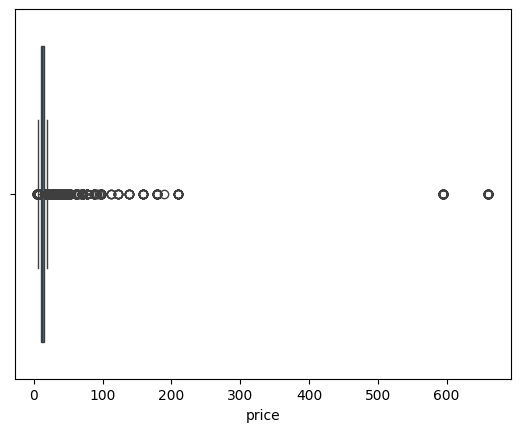

In [ ]:
# คำเตือน: Cell นี้อาจจะใช้เวลาประมาณ 50 วินาที เนื่องจากข้อมูลขนาดใหญ่
sns.boxplot(x = dt_clean_v4.toPandas()['price'])

เห็นได้ว่ามีสินค้าที่ราคาสูงกว่าข้อมูลส่วนใหญ่เยอะมาก ลองมาดูกันว่าสินค้าอะไรที่ราคาเกิน 600

In [ ]:
dt_clean_v4.where( dt_clean_v4.price > 600 ).select("product_id", "product_name", "price").distinct().show(truncate = False)

+----------+----------------------------+------+
|product_id|product_name                |price |
+----------+----------------------------+------+
|22656     |Vintage Blue Kitchen Cabinet|660.62|
|22655     |Vintage Red Kitchen Cabinet |660.62|
+----------+----------------------------+------+



ลองเอาชื่อสินค้าไปเสิร์จในกูเกิ้ลกัน ว่ามันแพงจริงมั้ย

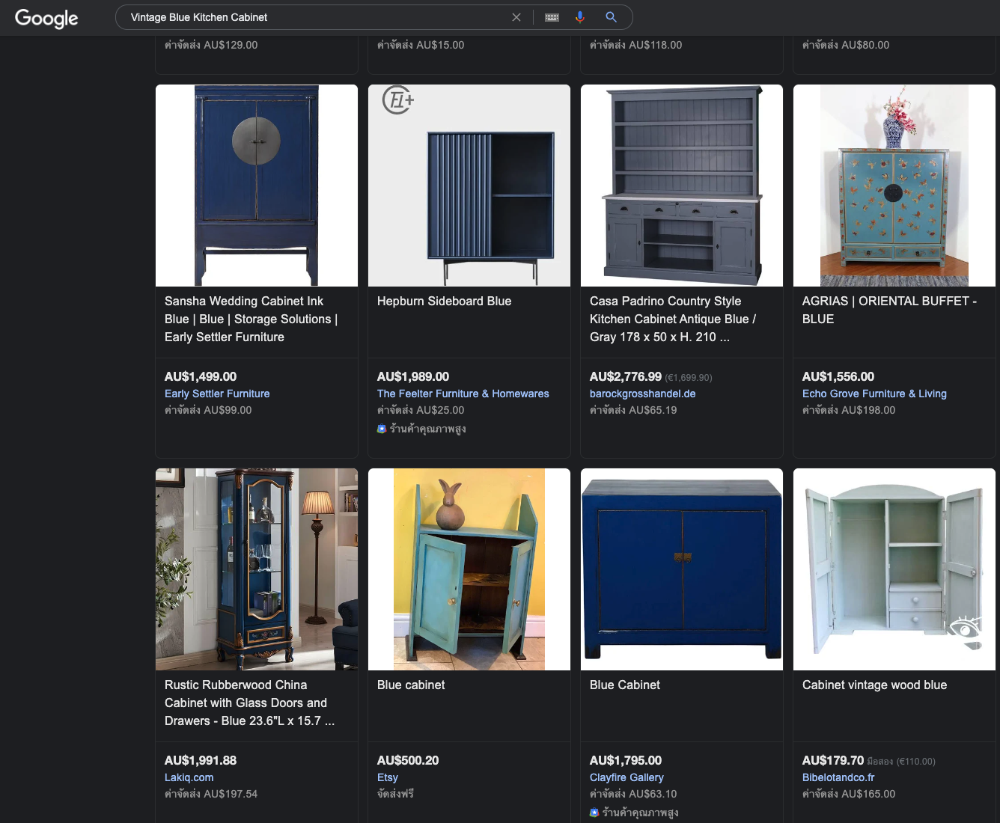

พบว่าเป็นตู้เก็บของ สินค้าขนาดใหญ่ และมีความ Vintage (สไตล์เก่า ๆ เท่ ๆ) อีก จึงไม่แปลกถ้าสินค้านี้จะแพง

**ในที่นี้ ถือว่าเป็น Outlier จริง แต่ไม่ได้เป็นข้อมูลที่ผิด จึงไม่ต้องแก้อะไร**

### มาลอง Clean ข้อมูลด้วย Spark SQL

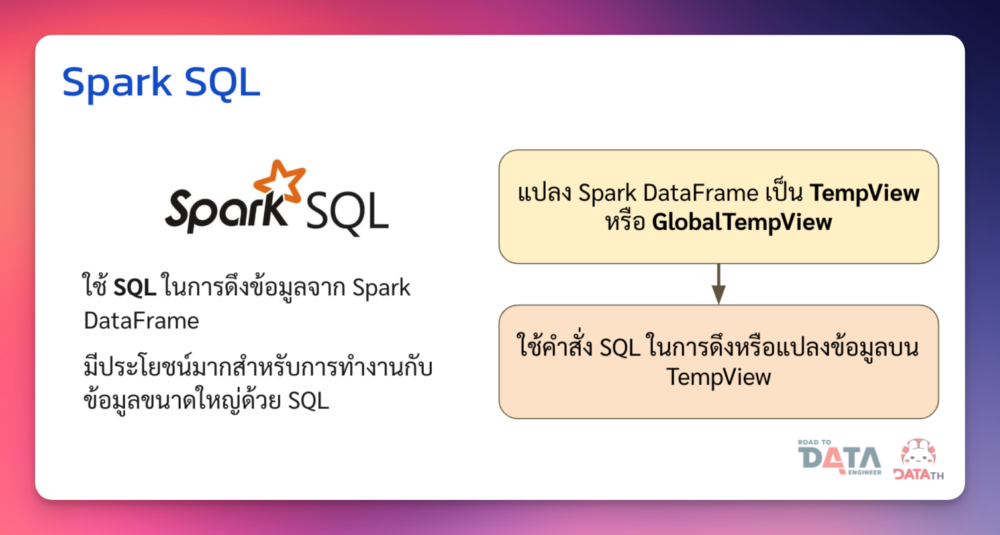

In [ ]:
# แปลงข้อมูลจาก Spark DataFrame ให้เป็น TempView ก่อน
dt.createOrReplaceTempView("data")
dt_sql = spark.sql("SELECT * FROM data")
dt_sql.show()

+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+
|transaction_id|      date|product_id|price|quantity|customer_id|        product_name|customer_country|customer_name|      total_amount|        thb_amount|
+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+
|        581482|2024-05-10|     22485|21.47|      12|    17490.0|Set Of 2 Wooden M...|  United Kingdom| Sara Griffin|            257.64|        11792.1828|
|        581475|2024-05-10|     22596|10.65|      36|    13069.0|Christmas Star Wi...|  United Kingdom| Michael Holt|383.40000000000003|17548.218000000004|
|        581475|2024-05-10|     23235|11.53|      12|    13069.0|Storage Tin Vinta...|  United Kingdom| Michael Holt|138.35999999999999|         6332.7372|
|        581475|2024-05-10|     23272|10.65|      12|    13069.0

In [ ]:
# ลองแปลงโค้ดสำหรับลิสต์ชื่อประเทศ Exercise 4 เป็น SQL
dt_sql_country = spark.sql("""
SELECT distinct customer_country
FROM data
ORDER BY customer_country
""")
dt_sql_country.show(100)

+--------------------+
|    customer_country|
+--------------------+
|           Australia|
|             Austria|
|             Bahrain|
|             Belgium|
|              Brazil|
|              Canada|
|     Channel Islands|
|              Cyprus|
|      Czech Republic|
|             Denmark|
|                EIRE|
|  European Community|
|             Finland|
|              France|
|             Germany|
|              Greece|
|           Hong Kong|
|             Iceland|
|              Israel|
|               Italy|
|               Japan|
|              Japane|
|             Lebanon|
|           Lithuania|
|               Malta|
|         Netherlands|
|              Norway|
|              Poland|
|            Portugal|
|                 RSA|
|        Saudi Arabia|
|           Singapore|
|               Spain|
|              Sweden|
|         Switzerland|
|                 USA|
|United Arab Emirates|
|      United Kingdom|
|         Unspecified|
+--------------------+



In [ ]:
# ลองแปลงโค้ดสำหรับแทนที่ชื่อประเทศ จาก Exercise 4 เป็น SQL
dt_sql_transform = spark.sql("""
SELECT
    transaction_id,
    date,
    product_id,
    price,
    quantity,
    customer_id,
    product_name,
    CASE WHEN customer_country = 'Japane' THEN 'Japan' ELSE customer_country END AS customer_country,
    customer_name,
    total_amount,
    thb_amount
FROM
    data
""")
dt_sql_transform.show()

+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+
|transaction_id|      date|product_id|price|quantity|customer_id|        product_name|customer_country|customer_name|      total_amount|        thb_amount|
+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+
|        581482|2024-05-10|     22485|21.47|      12|    17490.0|Set Of 2 Wooden M...|  United Kingdom| Sara Griffin|            257.64|        11792.1828|
|        581475|2024-05-10|     22596|10.65|      36|    13069.0|Christmas Star Wi...|  United Kingdom| Michael Holt|383.40000000000003|17548.218000000004|
|        581475|2024-05-10|     23235|11.53|      12|    13069.0|Storage Tin Vinta...|  United Kingdom| Michael Holt|138.35999999999999|         6332.7372|
|        581475|2024-05-10|     23272|10.65|      12|    13069.0

In [ ]:
# เช็คผลลัพธ์ว่าถูกจริงมั้ย
dt_sql_transform.select("customer_country").distinct().sort("customer_country").show(50)

+--------------------+
|    customer_country|
+--------------------+
|           Australia|
|             Austria|
|             Bahrain|
|             Belgium|
|              Brazil|
|              Canada|
|     Channel Islands|
|              Cyprus|
|      Czech Republic|
|             Denmark|
|                EIRE|
|  European Community|
|             Finland|
|              France|
|             Germany|
|              Greece|
|           Hong Kong|
|             Iceland|
|              Israel|
|               Italy|
|               Japan|
|             Lebanon|
|           Lithuania|
|               Malta|
|         Netherlands|
|              Norway|
|              Poland|
|            Portugal|
|                 RSA|
|        Saudi Arabia|
|           Singapore|
|               Spain|
|              Sweden|
|         Switzerland|
|                 USA|
|United Arab Emirates|
|      United Kingdom|
|         Unspecified|
+--------------------+



#### Exercise 7

ทำ Exercise 5 ด้วย SQL

คำใบ้: ใช้คำสั่ง RLIKE ใน SQL เพื่อตรวจเช็ครูปแบบ Regular Expression ได้

In [ ]:
# Solution: เช็คว่ามีข้อมูล product_id ที่ไม่เป็นตัวหนังสือหรือตัวเลข 5 หลักมั้ย
dt_sql_check_productid = spark.sql("""
SELECT *
FROM data
WHERE product_id NOT RLIKE '^.{5}$'
""").show()

+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+--------------+------------------+------------------+
|transaction_id|      date|product_id|price|quantity|customer_id|        product_name|customer_country| customer_name|      total_amount|        thb_amount|
+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+--------------+------------------+------------------+
|        581476|2024-05-10|    84596F|10.68|      32|    12433.0|Small Marshmallow...|          Norway|Kelli Sandoval|            341.76|        15642.3552|
|        581476|2024-05-10|    84596B|10.68|      16|    12433.0|Small Dolly Mix D...|          Norway|Kelli Sandoval|            170.88|         7821.1776|
|        581476|2024-05-10|    84510A|11.53|      20|    12433.0|Set Of 4 English ...|          Norway|Kelli Sandoval|             230.6|         10554.562|
|        581476|2024-05-10|    47559B|11.53|      10|    1

In [ ]:
# Solution: แทนค่า (ใช้ CASE WHEN ตามปกติ)
dt_sql_productid_clean = spark.sql("""
SELECT
    transaction_id,
    date,
    CASE
      WHEN length(product_id) > 5
      THEN substr(product_id, 1, 5)
      ELSE product_id
    END AS product_id,
    price,
    quantity,
    customer_id,
    product_name,
    customer_country,
    customer_name,
    total_amount,
    thb_amount
FROM
    data
""")
dt_sql_productid_clean.show()

+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+
|transaction_id|      date|product_id|price|quantity|customer_id|        product_name|customer_country|customer_name|      total_amount|        thb_amount|
+--------------+----------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+
|        581482|2024-05-10|     22485|21.47|      12|    17490.0|Set Of 2 Wooden M...|  United Kingdom| Sara Griffin|            257.64|        11792.1828|
|        581475|2024-05-10|     22596|10.65|      36|    13069.0|Christmas Star Wi...|  United Kingdom| Michael Holt|383.40000000000003|17548.218000000004|
|        581475|2024-05-10|     23235|11.53|      12|    13069.0|Storage Tin Vinta...|  United Kingdom| Michael Holt|138.35999999999999|         6332.7372|
|        581475|2024-05-10|     23272|10.65|      12|    13069.0

In [ ]:
# Solution - เช็คว่าข้อมูลหายไปหรือยัง
# เกร็ดเสริม: ~ = ไม่ใช่ (ทำให้เงื่อนไขที่เขียน กลายเป็นค่าตรงข้าม)
dt_sql_productid_clean.filter(~dt_sql_productid_clean["product_id"].rlike("^.{5}$")).show()

+--------------+----+----------+-----+--------+-----------+------------+----------------+-------------+------------+----------+
|transaction_id|date|product_id|price|quantity|customer_id|product_name|customer_country|customer_name|total_amount|thb_amount|
+--------------+----+----------+-----+--------+-----------+------------+----------------+-------------+------------+----------+
+--------------+----+----------+-----+--------+-----------+------------+----------------+-------------+------------+----------+



# Step 5) Data Export in PySpark

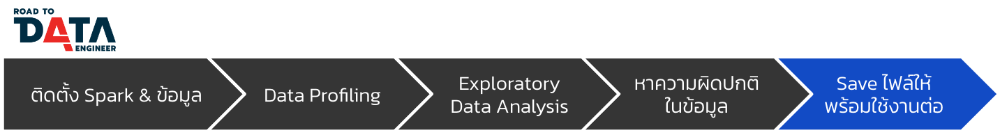

### Parquet Export

บันทึกเป็นไฟล์ Parquet ไฟล์น้ำหนักเบา และมีเก็บประเภทข้อมูลของแต่ละคอลัมน์ให้ด้วย

In [ ]:
dt_clean.write.parquet("cleaned_data_output.parquet")

ทดลองอ่านไฟล์ parquet ที่เพิ่งเซฟไป เพื่อเช็คว่าไฟล์ใช้ได้จริง

In [ ]:
dt2 = spark.read.parquet("cleaned_data_output.parquet")

dt2.show(10)

+--------------+-------------------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+
|transaction_id|               date|product_id|price|quantity|customer_id|        product_name|customer_country|customer_name|      total_amount|        thb_amount|
+--------------+-------------------+----------+-----+--------+-----------+--------------------+----------------+-------------+------------------+------------------+
|        581482|2024-05-10 00:00:00|     22485|21.47|      12|    17490.0|Set Of 2 Wooden M...|  United Kingdom| Sara Griffin|            257.64|        11792.1828|
|        581475|2024-05-10 00:00:00|     22596|10.65|      36|    13069.0|Christmas Star Wi...|  United Kingdom| Michael Holt|383.40000000000003|17548.218000000004|
|        581475|2024-05-10 00:00:00|     23235|11.53|      12|    13069.0|Storage Tin Vinta...|  United Kingdom| Michael Holt|138.35999999999999|         6332.7372|
|        5

ทดลองเขียนไฟล์ชื่อเดิม

In [ ]:
dt_clean.write.parquet("cleaned_data_output.parquet")

AnalysisException: [PATH_ALREADY_EXISTS] Path file:/content/cleaned_data_output.parquet already exists. Set mode as "overwrite" to overwrite the existing path.

จะเจอ Error ว่า `PATH_ALREADY_EXISTS` แก้โดยตั้ง mode = overwrite (เขียนทับ)

In [ ]:
dt_clean.write.mode("overwrite").parquet("cleaned_data_output.parquet")

### Bonus 5: CSV Export

ถ้าทำงานกับทีมที่ต้องใช้ตาราง CSV เราสามารถ Export จาก Spark ได้เลย (รัน 3 วินาที)

In [ ]:
# เซฟเป็น CSV
dt_clean.write.csv('cleaned_data.csv', header = True)

ง่ายจังเนอะ >,<

### Bonus 6: Excel Export

แต่ถ้าทีมบอกว่าอยากได้ Excel เราก็มีวิธีใช้ Pandas แฮ่ (แต่เพราะข้อมูลเยอะ จะใช้เวลานานในการรัน ประมาณ 3 นาที)

In [ ]:
dt_clean.toPandas().to_excel("output.xlsx")

----

In [ ]:
print('จบ Workshop 2 แล้วคร้าบ 😍')

จบ Workshop 2 แล้วคร้าบ 😍


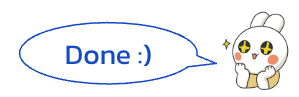